In [113]:
# ------------------ Clustering & ML ------------------
from sklearn.cluster import SpectralBiclustering
from scipy import stats

# ------------------ Core Libraries -------------------
import numpy as np
import pandas as pd
import math
import os
import warnings
import ast
from glob import glob

# ------------------ AnnData & Spatial Analysis -------
import scanpy as sc
import squidpy as sq
from anndata import AnnData
import geopandas as gpd

# ------------------ Geometry & Spatial --------------
from shapely.ops import unary_union
from shapely.geometry import Polygon as sPolygon
from matplotlib.patches import Polygon, Patch

# ------------------ Plotting -------------------------
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.cm as cm
import matplotlib.colors as colors
from matplotlib.colors import BoundaryNorm, LinearSegmentedColormap, ListedColormap, to_hex
import matplotlib.image as mpimg
import matplotlib as mpl

# ------------------ Image Handling -------------------
from PIL import Image
import cv2

# ------------------ Settings -------------------------
warnings.filterwarnings('ignore')
Image.MAX_IMAGE_PIXELS = None
%matplotlib inline

## Summary of Steps 1–6: CosMx Spatial Transcriptomics QC & filtering

1. **🗂️ Step 1: File Completeness Check**
   - Verify that all required CosMx output files are present
   - Ensure FOVs are properly named and all expected FOVs are available.

2. **📁 Step 2: Initialize Output Folder Structure**
   - Create directories to save results:
     ```
     results/
     ├── analysis/
     ├── data/
     ├── raw/
     └── script/
     ```
   - Ensures consistent storage of intermediate and final outputs.

3. **🧭 Step 3: Select FOVs for Analysis**
   - Define a subset of FOVs (e.g., `['001', '002', '003']`) to use throughout the analysis.
   - Filter all relevant data (expression, polygons, images) accordingly.

4. **🧬 Step 4: Visualize Morphological Markers**
   - Plot spatial expression of key markers (e.g., `PanCK`, `CD45`, `DAPI`) across unfiltered cells.
   - Used to validate data quality before applying filters.

5. **🧹 Step 5: Quality Control (QC)**
   - **Negative Probe QC** 
   - **Cell QC**
   - **FOV QC**
   - **Gene QC**
   - **Image QC**

6. **📏 Step 6: Filter**
   - Filter data based on above QC metrics
   - Save data

## Step 1: Check CosMx File Completeness

Before starting the analysis, we verify that all required CosMx output files are present. A typical CosMx dataset should include:

- 📁 `exprMat_file.csv` — gene expression matrix
- 📁 `metadata_file.csv` — cell segmentation metadata
- 📁 `tx_file.csv` — gene annotations
- 📁 `polygons.csv` — folder containing segmentation polygon `.csv` or `.json` files
- 📁 `fov_positions.csv` — spatial registration of FOVs
- 📁 `CellComposite/` — high-res composite or raw imaging files


## Step 2: Initialize Folder Structure for Output Saving

To keep outputs organized, we define a consistent folder structure for saving intermediate results, plots, and processed data.
```
project_root/ 
├── analysis/ # Processed results, visualizations, clustering outputs 
├── data/ # Cleaned or intermediate data 
├── raw/ # Original unprocessed CosMx output files 
└── script/ # Python or notebook scripts used for analysis
```

In [114]:
data_read = '../raw/' # for raw data 
data_save = '../data/' # for processed data or intermediate result
analysis_save = '../analysis/' # for plots


## Step 3: Select Specific FOVs for Analysis

CosMx datasets often include dozens of Fields of View (FOVs), but not all are necessary or suitable for a given analysis. In this step, we:

- Manually or programmatically select a subset of FOVs to include
- Filter associated files (e.g., expression matrices, segmentation polygons, images)
- Ensure consistency across modalities (expression, spatial coordinates, imaging)


In [145]:
fov_id = [i for i in range(1, 23) if i not in [3,20] ] # check image file names from CellComposite folder and fov_positions_file.csv under raw folder
print(fov_id)

fov_positions = pd.read_csv(data_read+"Run5452_S2_fov_positions_file.csv")
fov_positions = fov_positions[fov_positions['fov'].isin(fov_id)]


cell_meta = pd.read_csv(data_read+"Run5452_S2_metadata_file.csv")
cell_meta = cell_meta[cell_meta['fov'].isin(fov_id)]
cell_meta['cell'] = [str(i)+'_'+str(j) for i,j in zip(cell_meta['fov'].tolist(), cell_meta['cell_ID'].tolist())]


polygon_file = pd.read_csv(data_read+"Run5452_S2-Polygons.csv")
polygon_file = polygon_file[polygon_file['fov'].isin(fov_id)]
polygon_file['cell'] = [str(i)+'_'+str(j) for i,j in zip(polygon_file['fov'].tolist(), polygon_file['cell_ID'].tolist())]



[1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 21, 22]


In [116]:
cell_meta

,fov,cell_ID,Area,AspectRatio,CenterX_local_px,CenterY_local_px,CenterX_global_px,CenterY_global_px,Width,Height,...,Max.MembraneStain,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.CD3,Max.CD3,Mean.DAPI,Max.DAPI,cell
0,1,1,9074,1.97,1757,3612,5501.444444,10784.222222,144,73,...,119,77,1686,21,803,9,59,811,1835,1_1
1,1,2,7494,1.55,4931,3610,8675.444444,10782.222222,119,77,...,129,380,2126,10,830,1,27,153,1098,1_2
2,1,3,6621,1.25,5343,3609,9087.444444,10781.222222,99,79,...,97,15,1278,9,776,0,25,426,1486,1_3
3,1,4,3451,1.09,250,3617,3994.444444,10789.222222,70,64,...,104,276,1858,19,1040,1,73,11,143,1_4
4,1,5,10484,1.23,2758,3596,6502.444444,10768.222222,129,105,...,134,35,1657,18,984,4,47,395,1374,1_5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39934,22,3537,1774,1.73,4045,21,2972.777778,-9101.222222,71,41,...,118,3239,3878,17,102,17,56,644,929,22_3537
39935,22,3538,2871,1.79,4180,24,3107.777778,-9098.222222,84,47,...,154,3046,3878,27,86,16,46,818,1237,22_3538
39936,22,3539,2964,1.56,734,25,-338.222222,-9097.222222,75,48,...,50,888,3878,2,148,2,36,150,666,22_3539
39937,22,3540,2968,2.14,4392,22,3319.777778,-9100.222222,90,42,...,164,3062,3878,12,67,13,53,420,756,22_3540


In [117]:
polygon_file

,fov,cell_ID,x_local_px,y_local_px,x_global_px,y_global_px,cell
0,1,1,1822,3648,5566.444444,10820.222222,1_1
1,1,1,1823,3647,5567.444444,10819.222222,1_1
2,1,1,1827,3629,5571.444444,10801.222222,1_1
3,1,1,1828,3624,5572.444444,10796.222222,1_1
4,1,1,1828,3606,5572.444444,10778.222222,1_1
...,...,...,...,...,...,...,...
999571,22,3541,319,9,-753.222222,-9113.222222,22_3541
999572,22,3541,321,11,-751.222222,-9111.222222,22_3541
999573,22,3541,353,38,-719.222222,-9084.222222,22_3541
999574,22,3541,356,39,-716.222222,-9083.222222,22_3541


In [ ]:
# under most circumstances cell ID should start from 1 instead of 0
exprMat = pd.read_csv(data_read+"Run5452_S2_exprMat_file.csv")
exprMat = exprMat[exprMat['fov'].isin(fov_id)]
exprMat['cell'] = [str(i)+'_'+str(j) for i,j in zip(exprMat['fov'].tolist(), exprMat['cell_ID'].tolist())]
exprMat = exprMat[~(exprMat['cell_ID'] == 0)] # delete cell ID equaling 0
exprMat

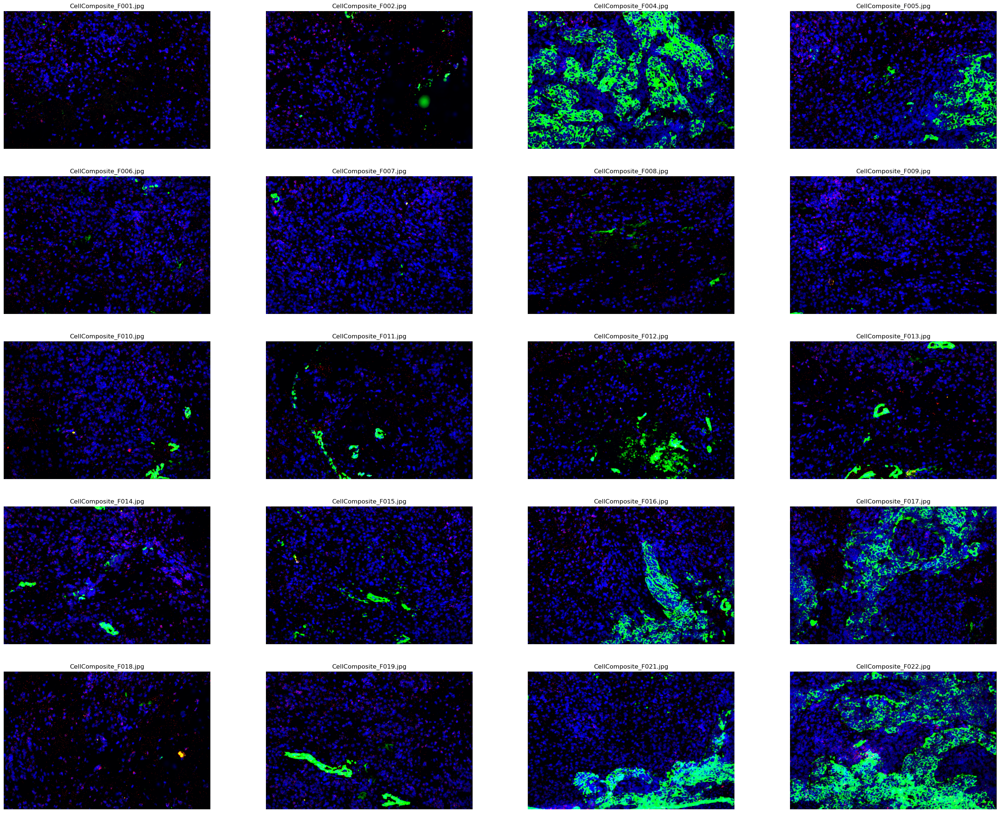

In [13]:
# show fov pictures (we have 20 in total and 5 rows * 4 columns to display them)
fig, axs = plt.subplots(5, 4, figsize=(7*5, 7*4))
axs = axs.flatten()
for idx,i in enumerate(['CellComposite_F0'+f'{fov:02d}'+'.jpg' for fov in fov_id]):
    # use opencv read image file
    image = cv2.imread(data_read+"CellComposite/"+i, cv2.IMREAD_COLOR)
    img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # set up image basic parameters
    ax = axs[idx]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(i)
plt.show()

## Step 4: Visualize Morphological Markers in Unfiltered Cells

Before any filtering or normalization, it's important to inspect the expression of morphological markers (e.g., **PanCK**, **CD45**, **CD3**, **E-cadherin**) across all cells to (**polygon and dot plots**):

- Validate tissue quality
- Understand spatial context
- Identify background noise or artifacts


In [16]:
# Since all images are usually of the same size and we just load the first image to get dimensions of it
image = cv2.imread(data_read+"CellComposite/"+"CellComposite_F001.jpg", cv2.IMREAD_COLOR)
xlim_image = image.shape[1]
ylim_image = image.shape[0]

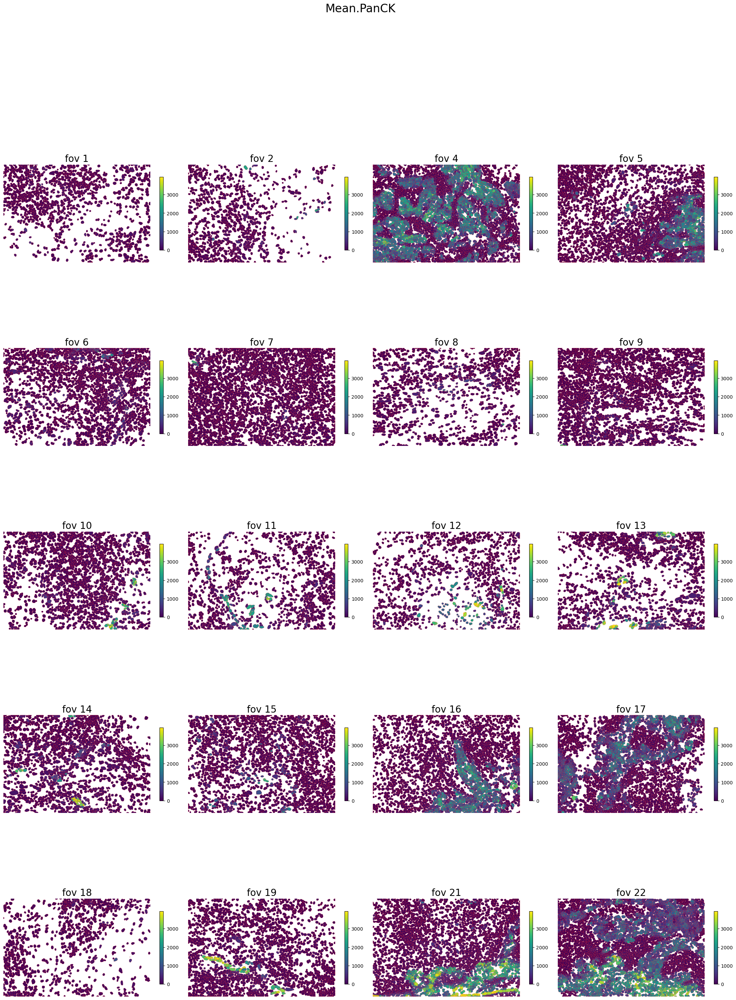

In [40]:
# Define the function to visualize continuous features based on polygon coordinates
def plot_polygon_by_features(polygon_file, feature_df, feature, fov_id, analysis_save, xlim_image, ylim_image, len_image_col=4):
    """
    Parameters
    ----------
    polygon_file : pd.DataFrame
        A long-format DataFrame with polygon coordinates for each cell.
        Must include: 'cell', 'fov', 'x_local_px', 'y_local_px'.

    feature_df : pd.DataFrame
        DataFrame containing cell-level features.
        Must include columns: 'cell' and the specified feature name.

    feature : str
        The name of the feature/column in `feature_df` to visualize (e.g., 'Mean.PanCK').

    fov_id : list
        A list of FOV IDs (integers or strings) to plot.

    analysis_save : str
        Path to the folder where the output image will be saved.

    xlim_image : int or float
        Maximum x-dimension of the image canvas for plotting polygons.

    ylim_image : int or float
        Maximum y-dimension of the image canvas for plotting polygons.

    len_image_col : int, optional (default=4)
        Number of columns in the subplot grid layout.
        Rows will be computed automatically based on number of FOVs.
    """
    feature_df = feature_df[['cell',feature]]
    df = feature_df.merge(polygon_file, on='cell')
    
    len_image = len(fov_id)
    len_image_col = len_image_col
    len_image_row = int(np.ceil(len_image/len_image_col))
    
    
    norm = colors.Normalize(vmin=df[feature].min(), vmax=df[feature].max())
    fig, axs = plt.subplots(len_image_row, len_image_col, figsize=(7*len_image_col, 7*len_image_row))
    
    axs = axs.flatten()
    for ax,i in enumerate(fov_id):
        df1 = df[df['fov'] == i]
        
        cmap = cm.viridis
        ax = axs[ax]
        
        polygons = []
        for cell_id, group in df1.groupby("cell"):
            color = cmap(norm(group[feature].iloc[0]))
            coords = group[['x_local_px','y_local_px']].values
            polygons.append(mpl.patches.Polygon(coords, closed=True, facecolor=color, edgecolor='red', linewidth=0.2))

        for j in polygons:
            ax.add_patch(j)
        
        ax.set_aspect('equal')

        ax.set_xlim(0, xlim_image)
        ax.set_ylim(0, ylim_image)


        sm = cm.ScalarMappable(norm=norm, cmap=cmap)
        sm.set_array([])  # required for matplotlib >= 3.1
        cbar = fig.colorbar(sm, ax=ax, shrink=0.4)
        
        ax.set_title('fov '+str(i), fontsize=20)
        ax.axis('off')
        
    if len(fov_id) < len(axs):
        for j in range(len(fov_id), len(axs)):
            axs[j].axis('off')
    
    plt.suptitle(feature, fontsize=24)
    plt.subplots_adjust(wspace=0.005, hspace=0.005)
    plt.savefig(analysis_save+'polygon_'+feature+'_fov.png')
    plt.show()

# test run below code if necessary
plot_polygon_by_features(polygon_file, cell_meta, 'Mean.PanCK', fov_id, analysis_save,xlim_image, ylim_image, 4)

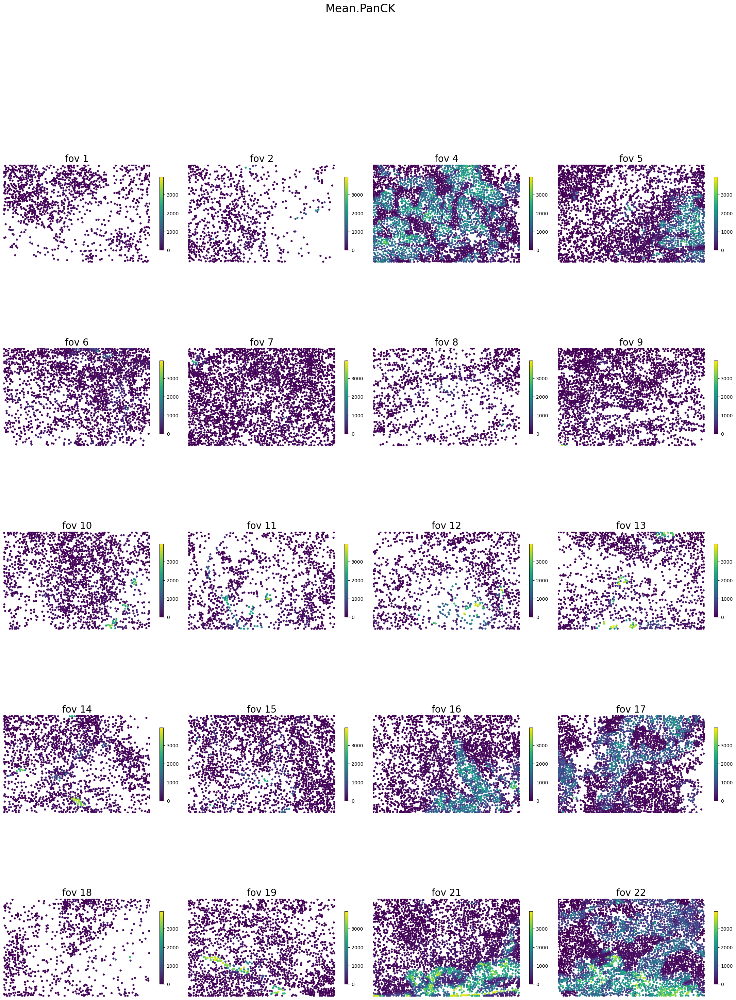

In [39]:
# Define the function to visualize continuous features based on dot coordinates
def plot_dot_by_features(dot_file, feature_df, feature, fov_id, analysis_save, xlim_image, ylim_image, len_image_col=4):
    """
    Parameters
    ----------
    dot_file : pd.DataFrame
        A long-format DataFrame with polygon coordinates for each cell.
        Must include: 'cell', 'fov', 'x_local_px', 'y_local_px'.

    feature_df : pd.DataFrame
        DataFrame containing cell-level features.
        Must include columns: 'cell' and the specified feature name.

    feature : str
        The name of the feature/column in `feature_df` to visualize (e.g., 'Mean.PanCK').

    fov_id : list
        A list of FOV IDs (integers or strings) to plot.

    analysis_save : str
        Path to the folder where the output image will be saved.

    xlim_image : int or float
        Maximum x-dimension of the image canvas for plotting polygons.

    ylim_image : int or float
        Maximum y-dimension of the image canvas for plotting polygons.

    len_image_col : int, optional (default=4)
        Number of columns in the subplot grid layout.
        Rows will be computed automatically based on number of FOVs.
    """
    feature_df = feature_df[['cell', feature]]
    df = feature_df.merge(dot_file, on='cell')
    
    len_image = len(fov_id)
    len_image_col = len_image_col
    len_image_row = int(np.ceil(len_image/len_image_col))

    # Set color normalization globally
    norm = colors.Normalize(vmin=df[feature].min(), vmax=df[feature].max())
    cmap = cm.viridis

    fig, axs = plt.subplots(len_image_row, len_image_col, figsize=(7*len_image_col, 7*len_image_row))
    axs = axs.flatten()

    for idx, fov in enumerate(fov_id):
        ax = axs[idx]
        df1 = df[df['fov'] == fov]

        # Pick a point per cell — you can use the centroid or first point
        cell_points = df1.groupby("cell")[["CenterX_local_px", "CenterY_local_px", feature]].mean().reset_index()

        sc = ax.scatter(
            cell_points["CenterX_local_px"],
            cell_points["CenterY_local_px"],
            c=cell_points[feature],
            cmap=cmap,
            norm=norm,
            s=20,             # size of dots
            edgecolors='none' # optional
        )

        ax.set_aspect('equal')
        ax.set_xlim(0, xlim_image)
        ax.set_ylim(0, ylim_image)
        ax.set_title(f'fov {fov}', fontsize=20)
        ax.axis('off')

        # Add colorbar
        sm = cm.ScalarMappable(norm=norm, cmap=cmap)
        sm.set_array([])
        cbar = fig.colorbar(sm, ax=ax, shrink=0.4)

    # Hide empty subplots if any
    for j in range(len(fov_id), len(axs)):
        axs[j].axis('off')

    # Global title and layout
    plt.suptitle(feature, fontsize=24)
    plt.subplots_adjust(wspace=0.005, hspace=0.005)
    plt.savefig(os.path.join(analysis_save, f'dotplot_{feature}_fov.png'))
    plt.show()

# test run below code if necessary
plot_dot_by_features(cell_meta[['CenterX_local_px','CenterY_local_px','cell', 'fov']], cell_meta[['cell','Mean.PanCK']], 'Mean.PanCK', fov_id, analysis_save,xlim_image, ylim_image, len_image_col=4)

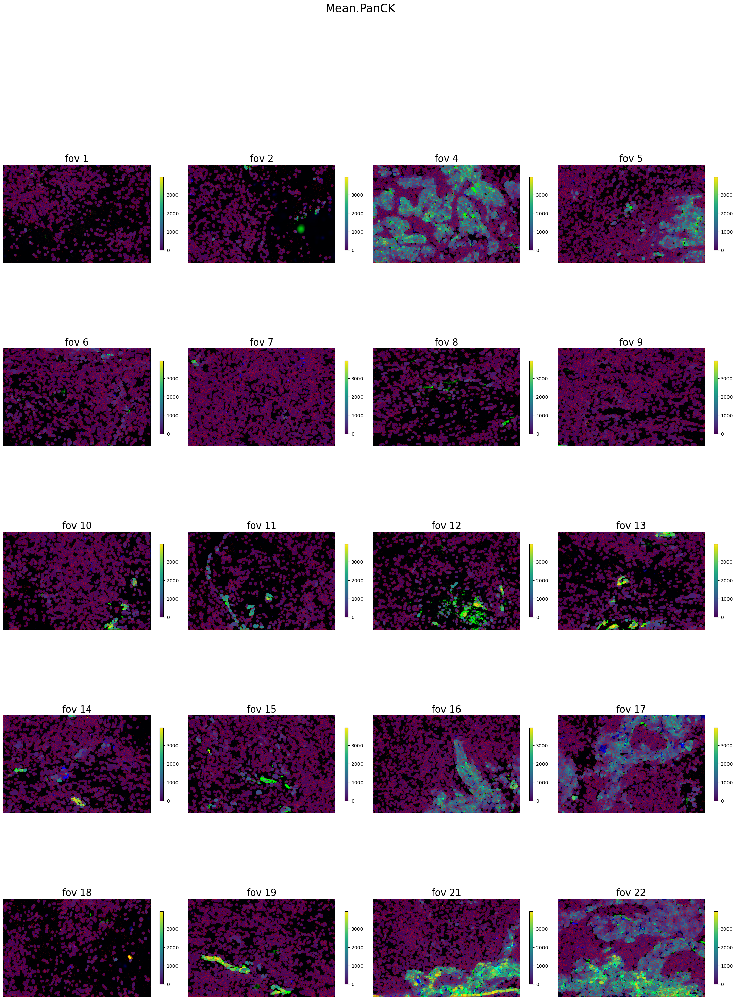

In [34]:
# Define the function to visualize continuous features based on polygon coordinates
def plot_polygon_by_features_over_image(polygon_file, feature_df, feature, fov_id, analysis_save, xlim_image, ylim_image, image_path,len_image_col=4):
    """
    Parameters
    ----------
    polygon_file : pd.DataFrame
        A long-format DataFrame with polygon coordinates for each cell.
        Must include: 'cell', 'fov', 'x_local_px', 'y_local_px'.

    feature_df : pd.DataFrame
        DataFrame containing cell-level features.
        Must include columns: 'cell' and the specified feature name.

    feature : str
        The name of the feature/column in `feature_df` to visualize (e.g., 'Mean.PanCK').

    fov_id : list
        A list of FOV IDs (integers or strings) to plot.

    analysis_save : str
        Path to the folder where the output image will be saved.

    xlim_image : int or float
        Maximum x-dimension of the image canvas for plotting polygons.

    ylim_image : int or float
        Maximum y-dimension of the image canvas for plotting polygons.
        
    image_path : str
        The path to the folder of image.
        
    len_image_col : int, optional (default=4)
        Number of columns in the subplot grid layout.
        Rows will be computed automatically based on number of FOVs.
    """
    feature_df = feature_df[['cell',feature]]
    df = feature_df.merge(polygon_file, on='cell')
    
    
    len_image = len(fov_id)
    len_image_col = len_image_col
    len_image_row = int(np.ceil(len_image/len_image_col))
    
    
    norm = colors.Normalize(vmin=df[feature].min(), vmax=df[feature].max())
    fig, axs = plt.subplots(len_image_row, len_image_col, figsize=(7*len_image_col, 7*len_image_row))
    
    axs = axs.flatten()
    for ax,i in enumerate(fov_id):
        image = cv2.imread(image_path+'CellComposite_F0'+f'{i:02d}'+'.jpg', cv2.IMREAD_COLOR)
        img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        df1 = df[df['fov'] == i]
        
        cmap = cm.viridis
        ax = axs[ax]
        ax.imshow(cv2.flip(img,0))
        
        polygons = []
        for cell_id, group in df1.groupby("cell"):
            color = cmap(norm(group[feature].iloc[0]))
            coords = group[['x_local_px','y_local_px']].values
            polygons.append(mpl.patches.Polygon(coords, closed=True, facecolor=color, edgecolor='red', linewidth=0.2))

        for j in polygons:
            ax.add_patch(j)
        
        ax.set_aspect('equal')

        ax.set_xlim(0, xlim_image)
        ax.set_ylim(0, ylim_image)


        sm = cm.ScalarMappable(norm=norm, cmap=cmap)
        sm.set_array([])  # required for matplotlib >= 3.1
        cbar = fig.colorbar(sm, ax=ax, shrink=0.4)
        
        ax.set_title('fov '+str(i), fontsize=20)
        ax.axis('off')
        
    if len(fov_id) < len(axs):
        for j in range(len(fov_id), len(axs)):
            axs[j].axis('off')
    
    plt.suptitle(feature, fontsize=24)
    plt.subplots_adjust(wspace=0.005, hspace=0.005)
    plt.savefig(analysis_save+'polygon_'+feature+'_over_image_fov.png')
    plt.show()

# test run below code if necessary
plot_polygon_by_features_over_image(polygon_file, cell_meta, 'Mean.PanCK', fov_id, analysis_save,xlim_image, ylim_image, image_path=data_read+'CellComposite/')

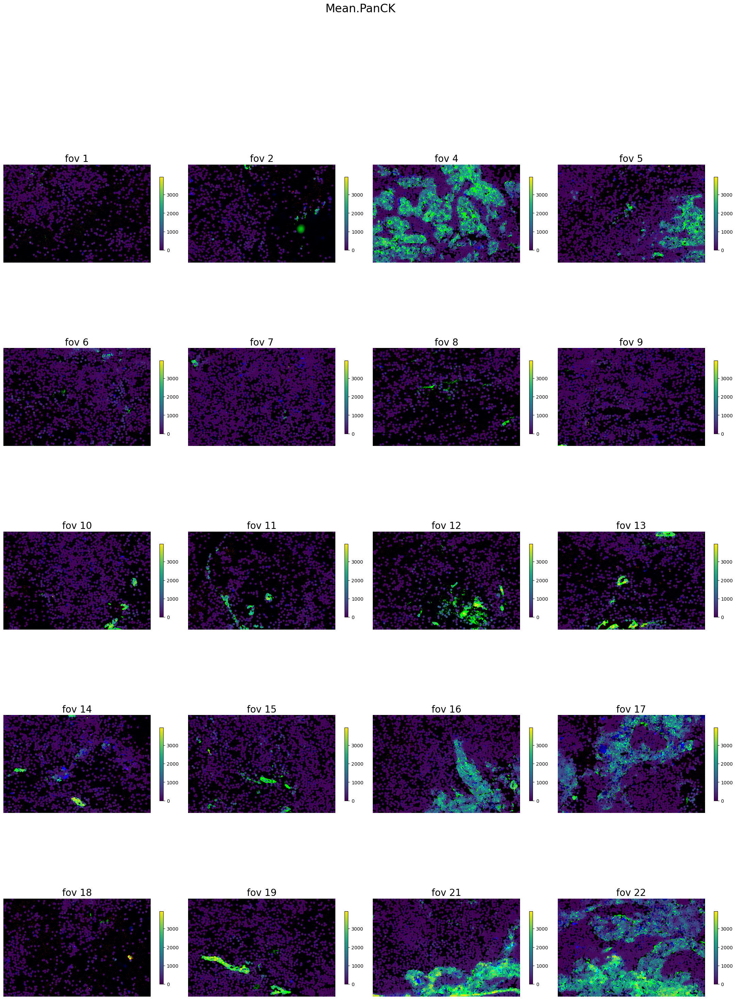

In [38]:
# Define the function to visualize continuous features based on dot coordinates
def plot_dot_by_features_over_image(dot_file, feature_df, feature, fov_id, analysis_save, xlim_image, ylim_image,image_path, len_image_col=4):
    """
    Parameters
    ----------
    dot_file : pd.DataFrame
        A long-format DataFrame with polygon coordinates for each cell.
        Must include: 'cell', 'fov', 'x_local_px', 'y_local_px'.

    feature_df : pd.DataFrame
        DataFrame containing cell-level features.
        Must include columns: 'cell' and the specified feature name.

    feature : str
        The name of the feature/column in `feature_df` to visualize (e.g., 'Mean.PanCK').

    fov_id : list
        A list of FOV IDs (integers or strings) to plot.

    analysis_save : str
        Path to the folder where the output image will be saved.
        

    xlim_image : int or float
        Maximum x-dimension of the image canvas for plotting polygons.

    ylim_image : int or float
        Maximum y-dimension of the image canvas for plotting polygons.
    
    image_path : str
        The path to the folder of image.
    
    len_image_col : int, optional (default=4)
        Number of columns in the subplot grid layout.
        Rows will be computed automatically based on number of FOVs.
    """
    feature_df = feature_df[['cell', feature]]
    df = feature_df.merge(dot_file, on='cell')
    
    len_image = len(fov_id)
    len_image_col = len_image_col
    len_image_row = int(np.ceil(len_image/len_image_col))

    # Set color normalization globally
    norm = colors.Normalize(vmin=df[feature].min(), vmax=df[feature].max())
    cmap = cm.viridis

    fig, axs = plt.subplots(len_image_row, len_image_col, figsize=(7*len_image_col, 7*len_image_row))
    axs = axs.flatten()

    for idx, fov in enumerate(fov_id):
        
        image = cv2.imread(image_path+'CellComposite_F0'+f'{fov:02d}'+'.jpg', cv2.IMREAD_COLOR)
        img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        ax = axs[idx]
        df1 = df[df['fov'] == fov]
        ax.imshow(cv2.flip(img,0))
        # Pick a point per cell — you can use the centroid or first point
        cell_points = df1.groupby("cell")[["CenterX_local_px", "CenterY_local_px", feature]].mean().reset_index()

        sc = ax.scatter(
            cell_points["CenterX_local_px"],
            cell_points["CenterY_local_px"],
            c=cell_points[feature],
            cmap=cmap,
            norm=norm,
            s=20,             # size of dots
            edgecolors='none' # optional
        )

        ax.set_aspect('equal')
        ax.set_xlim(0, xlim_image)
        ax.set_ylim(0, ylim_image)
        ax.set_title(f'fov {fov}', fontsize=20)
        ax.axis('off')

        # Add colorbar
        sm = cm.ScalarMappable(norm=norm, cmap=cmap)
        sm.set_array([])
        cbar = fig.colorbar(sm, ax=ax, shrink=0.4)

    # Hide empty subplots if any
    for j in range(len(fov_id), len(axs)):
        axs[j].axis('off')

    # Global title and layout
    plt.suptitle(feature, fontsize=24)
    plt.subplots_adjust(wspace=0.005, hspace=0.005)
    plt.savefig(os.path.join(analysis_save, f'dotplot_{feature}_over_image_fov.png'))
    plt.show()

# test run below code if necessary
plot_dot_by_features_over_image(cell_meta[['CenterX_local_px','CenterY_local_px','cell', 'fov']], cell_meta[['cell','Mean.PanCK']], 'Mean.PanCK', fov_id, analysis_save,xlim_image, ylim_image, image_path=data_read+'CellComposite/')

## Step 5: Quality Control – Filter Genes and Cells

We apply quality control (QC) to remove low-quality cells and uninformative genes before downstream analysis.

### 🔍 Goals of This Step:
- Remove **cells** with too few detected genes or total counts (potential debris or segmentation errors)
- Remove **genes** that are lowly expressed across the dataset
- Optionally remove cells with extremely high counts (potential doublets)

### **Common Filtering Criteria**:
### Negative Probe QC
- Remove probes flagged for QC failure
- Apply **Grubb's test** with p-value cutoff of `0.01` to detect outliers

---

### Cell-Level QC

#### **Minimum Counts per Cell**
- ≥ 20 for 1K gene panel
- ≥ 50 for 6K gene panel

#### **Proportion of Negative Probe Counts**
- Cells with >10% negative probe counts are excluded

#### **Count Distribution Check**
- Compute:  
  `(Total Counts) / (Number of Detected Genes)`
- Must be **> 1**

#### **Mitochondrial Content** (optional)
- Filter cells with **>25% mitochondrial transcripts**
- Note: CosMx often lacks mitochondrial gene detection by default

#### **Area Outlier Detection**
- Use **Grubb's test** for identifying area outliers
- p-value cutoff: `0.01` (stringent filtering)

---

### FOV-Level QC

- **90th percentile** gene count per cell should be **≫ median** of negative probes
- **Average transcripts per cell** must be **> 100**

---

### Target-Level (Gene) QC

#### **Negative Control Quantile Cutoff**
- Keep only genes with **total counts > 50th percentile** of negative control probe distribution

#### **Detection Threshold**
- Filter genes using detection p-value cutoff:  
  `p > 0.01` → **filtered out**

---

### Image & Metadata Checks

- Ensure FOVs are connected/scattered or arranged correctly
- Make sure **all expected FOVs are present**

---


In [64]:
# QC 
## read in counts firstly
counts = exprMat.copy()
counts.index = counts['cell'].tolist()
counts = counts.iloc[:, ~counts.columns.str.contains("fov|cell_ID|cell")]

adata = AnnData(counts)
adata.var['mt'] = adata.var_names.str.startswith("MT-")
adata.var['ribo'] = adata.var_names.str.startswith("RPS", "RPL")
adata.var['NegProbe'] = adata.var_names.str.startswith("Neg") # check whether we have other weird gene name except for MT- or Neg
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt", "ribo", "NegProbe"], inplace=True, log1p=True
)

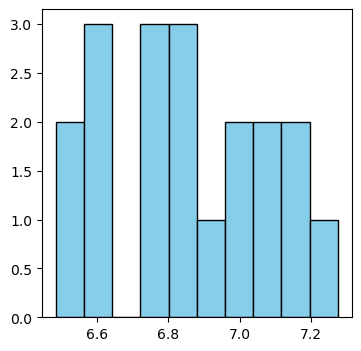

In [65]:
## Negative Probe QC
NegProbe = adata.var[adata.var['NegProbe'] == True].index.tolist()
NegProbe = counts[NegProbe]
NegProbe = NegProbe.sum()
def grubbs_test(data, alpha=0.05):
    data = np.array(data)
    n = len(data)
    mean = np.mean(data)
    std = np.std(data, ddof=1)
    
    # Calculate G statistic
    deviations = np.abs(data - mean)
    max_idx = np.argmax(deviations)
    G = deviations[max_idx] / std

    # Calculate critical G value
    t_crit = stats.t.ppf(1 - alpha / (2 * n), n - 2)
    G_crit = ((n - 1) / np.sqrt(n)) * np.sqrt(t_crit**2 / (n - 2 + t_crit**2))
    
    if G > G_crit:
        return max_idx  # Index of the outlier
    else:
        return -1     # No outlier detected
plt.figure(figsize=[4,4])
plt.hist(np.log1p(NegProbe.tolist()), color='skyblue', edgecolor='black')
plt.savefig(analysis_save+"QC_NegProbe_log1p.png")
plt.show()
idx_Neg = grubbs_test(np.log1p(NegProbe.tolist()), alpha=0.01) # no outliers detected
if idx_Neg != -1:
    adata.var['QC_Neg_outlier'] = [ i == NegProbe.index[idx_Neg] for i in adata.var.index]


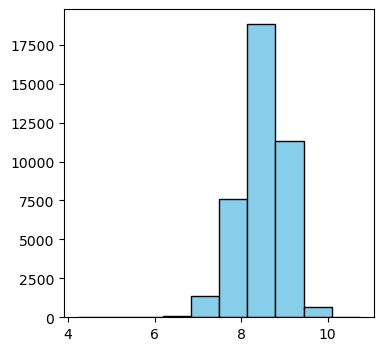

In [66]:
## Cell Level QC
### Area of cells QC
cell_area = cell_meta[['cell','Area']]

def grubbs_test(data, alpha=0.05):
    data = np.array(data)
    n = len(data)
    mean = np.mean(data)
    std = np.std(data, ddof=1)
    
    # Calculate G statistic
    deviations = np.abs(data - mean)
    max_idx = np.argmax(deviations)
    G = deviations[max_idx] / std

    # Calculate critical G value
    t_crit = stats.t.ppf(1 - alpha / (2 * n), n - 2)
    G_crit = ((n - 1) / np.sqrt(n)) * np.sqrt(t_crit**2 / (n - 2 + t_crit**2))
    
    if G > G_crit:
        return max_idx  # Index of the outlier
    else:
        return -1     # No outlier detected

plt.figure(figsize=[4,4])
plt.hist(np.log1p(cell_area['Area'].tolist()), color='skyblue', edgecolor='black')
plt.savefig(analysis_save+"QC_cell_area_log1p.png")
plt.show()
idx_cell_area = grubbs_test(np.log1p(cell_area['Area'].tolist()), alpha=0.01) 
if idx_cell_area != -1:
    adata.obs['QC_Area_outlier'] = [ i == cell_area.index[idx_cell_area] for i in adata.obs.index]


ratio_counts_genes


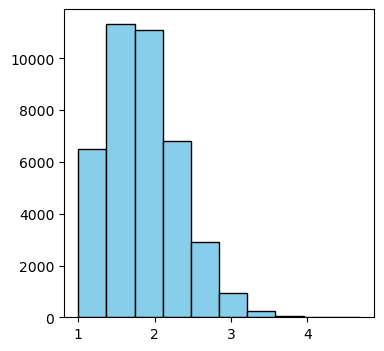

total_counts


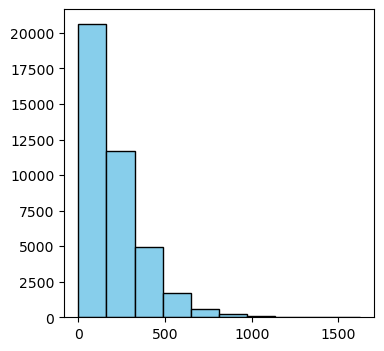

pct_counts_mt


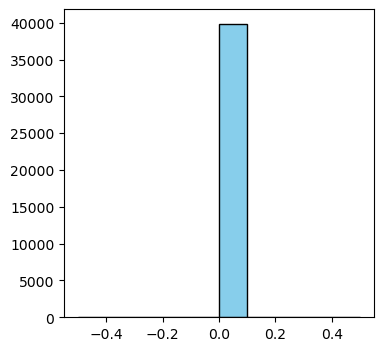

pct_counts_NegProbe


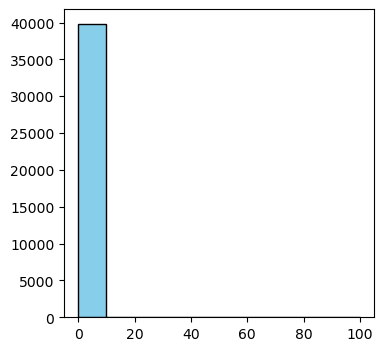

In [67]:
### QC for ratio_counts_genes total_counts pct_counts_mt pct_counts_NegProbe
adata.obs['ratio_counts_genes'] = adata.obs['total_counts']/adata.obs['n_genes_by_counts']
df = adata.obs[['ratio_counts_genes','total_counts','pct_counts_mt','pct_counts_NegProbe']]

for i in df.columns.tolist():
    print(i)
    plt.figure(figsize=[4,4])
    plt.hist(df[i].tolist(), color='skyblue', edgecolor='black')
    plt.savefig(analysis_save+"QC_"+i+".png")
    plt.show()

In [68]:
### cell filtering
df = adata.obs
df = df[(df['pct_counts_NegProbe'] < 0.1) & (df['pct_counts_mt'] < 0.25) & (df['ratio_counts_genes'] > 1) & (df['total_counts'] > 20) & (df['QC_Area_outlier'] == False)]
df_obs = df
df_obs


,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,total_counts_ribo,log1p_total_counts_ribo,pct_counts_ribo,total_counts_NegProbe,log1p_total_counts_NegProbe,pct_counts_NegProbe,QC_Area_outlier,ratio_counts_genes
1_3,44,3.806662,62,4.143135,100.000000,100.000000,100.0,100.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,False,1.409091
1_5,199,5.298317,572,6.350886,67.657343,82.692308,100.0,100.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,False,2.874372
1_7,164,5.105945,508,6.232448,75.984252,87.401575,100.0,100.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,False,3.097561
1_9,29,3.401197,35,3.583519,100.000000,100.000000,100.0,100.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,False,1.206897
1_10,71,4.276666,124,4.828314,83.064516,100.000000,100.0,100.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,False,1.746479
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22_3533,73,4.304065,105,4.663439,78.095238,100.000000,100.0,100.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,False,1.438356
22_3534,142,4.962845,289,5.669881,66.435986,85.467128,100.0,100.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,False,2.035211
22_3535,83,4.430817,139,4.941642,76.258993,100.000000,100.0,100.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,False,1.674699
22_3536,123,4.820282,220,5.398163,66.818182,89.545455,100.0,100.0,0,0.0,0.0,0,0.0,0.0,0,0.0,0.0,False,1.788618


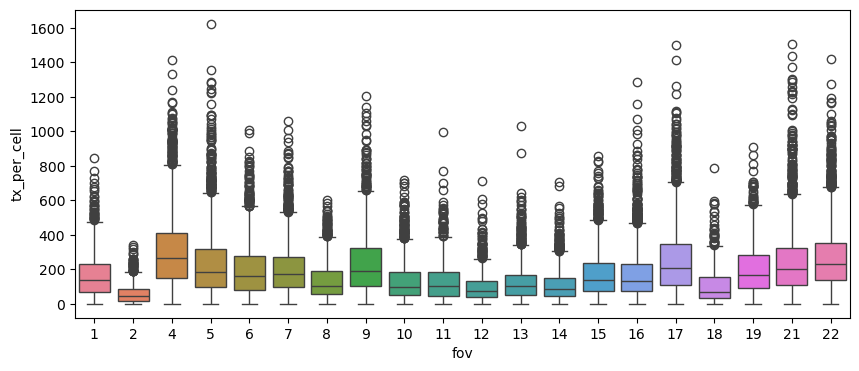

In [69]:
## FOV-Level QC
### QC for fov avg tx-per-cell
df = counts.copy()
fov = df.index.str.split("_")
fov = [i[0] for i in fov]
df_tx = df
df_tx['tx_per_cell'] = df.T.sum().tolist()
df_tx['fov'] = fov

plt.figure(figsize=[10,4])
sns.boxplot(data=df_tx, hue='fov', x='fov', y='tx_per_cell')
plt.savefig(analysis_save+"QC_fov_avg_per_cell.png")
plt.show()

df_tx[['tx_per_cell','fov']].groupby('fov').mean().to_csv(data_save+'fov_avg_per_cell.csv')

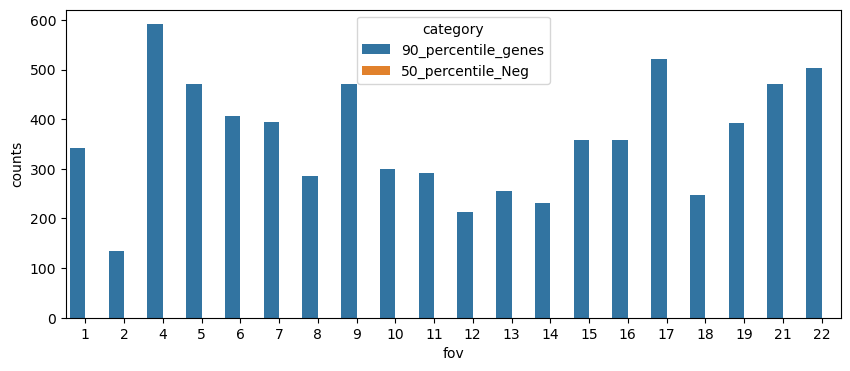

In [70]:
### QC for fov 90th percentile of sums of genes >> median of sums of negs
df = counts.copy()
fov = df.index.str.split("_")
fov = [i[0] for i in fov]
df_gene = df.iloc[:,~df.columns.str.contains('Neg')]
df_gene['genes'] = df_gene.T.sum().tolist()
df_gene['fov'] = fov

df_Neg = df.iloc[:,df.columns.str.contains('Neg')]
df_Neg['Neg'] = df_Neg.T.sum().tolist()
df_Neg['fov'] = fov

df_FOV = pd.DataFrame(index=df_Neg.groupby('fov').Neg.quantile(0.5).index.tolist())
df_FOV['90_percentile_genes'] = df_gene.groupby('fov').genes.quantile(0.9).tolist()
df_FOV['50_percentile_Neg'] = df_Neg.groupby('fov').Neg.quantile(0.5).tolist()

df_FOV.to_csv(data_save+'fov_90_gene_50_Neg.csv')
df_FOV['fov'] = df_FOV.index.tolist()
df_FOV['fov'] = df_FOV['fov'].astype('category')
df_FOV['fov'] = df_FOV['fov'].cat.reorder_categories([str(i) for i in fov_id], ordered=True)
df_FOV = df_FOV.melt(var_name='category', value_name='counts', id_vars='fov')

plt.figure(figsize=(10,4))
sns.barplot(data=df_FOV, hue='category', x='fov', y='counts')
plt.savefig(analysis_save+'QC_fov_90_gene_50_Neg.png')
plt.show()


In [72]:
## Genes QC
df = counts.copy()
df_gene = df.iloc[:, ~df.columns.str.contains('Neg')]
df_Neg = df.iloc[:, df.columns.str.contains('Neg')]
tmp = df_gene.sum()>int(np.percentile(df_Neg.sum(), 50))
df_gene = df_gene.iloc[:,tmp.tolist()]



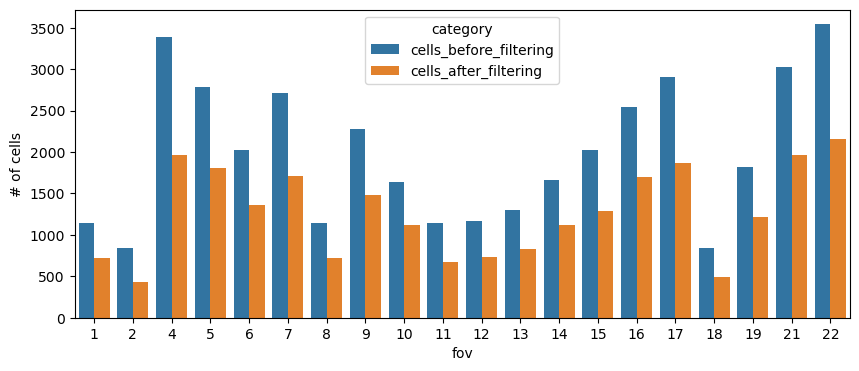

In [75]:
## summary of QC for cells
fov = df_obs.index.str.split("_")
fov = [i[0] for i in fov]
df_obs['fov'] = fov
tmp = pd.DataFrame(df_obs.groupby('fov').size(), columns=['cells_after_filtering'])

df_obs_raw = adata.obs
fov = df_obs_raw.index.str.split("_")
fov = [i[0] for i in fov]
df_obs_raw['fov'] = fov
tmp1 = pd.DataFrame(df_obs_raw.groupby('fov').size(), columns=['cells_before_filtering'])

df_summary = pd.concat([tmp, tmp1], axis=1)
df_summary.to_csv(data_save+'QC_cells.csv')
df_summary['fov'] = df_summary.index.tolist()
df_summary['fov'] = df_summary['fov'].astype('category')
df_summary['fov'] = df_summary['fov'].cat.reorder_categories([str(i) for i in fov_id], ordered=True)
df_summary = df_summary.melt(var_name='category', value_name='cells', id_vars='fov')
df_summary['category'] = df_summary['category'].astype('category')
df_summary['category'] = df_summary['category'].cat.reorder_categories(['cells_before_filtering','cells_after_filtering'], ordered=True)

plt.figure(figsize=(10,4))
sns.barplot(data=df_summary, hue='category', x='fov', y='cells')
plt.ylabel('# of cells')
plt.savefig(analysis_save+'QC_cells_filtering.png')
plt.show()

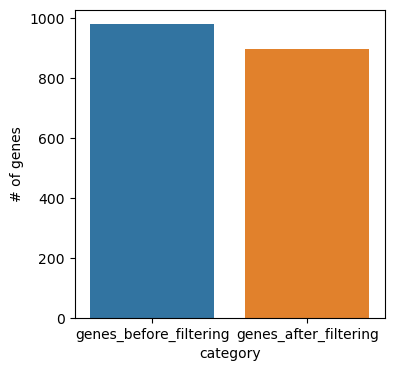

In [76]:
## summary of QC for genes
df_genes = pd.DataFrame({'genes_before_filtering': [adata.var.shape[0]],
              'genes_after_filtering': [df_gene.shape[1]]}, index=['all_fov'])
df_genes.to_csv(data_save+'QC_genes.csv')
df_genes = df_genes.melt(var_name='category', value_name='genes')
df_genes['category'] = df_genes['category'].astype('category')
df_genes['category'] = df_genes['category'].cat.reorder_categories(['genes_before_filtering','genes_after_filtering'], ordered=True)

plt.figure(figsize=(4,4))
sns.barplot(data=df_genes, hue='category', x='category', y='genes')
plt.ylabel('# of genes')
plt.savefig(analysis_save+'QC_genes_filtering.png')
plt.show()

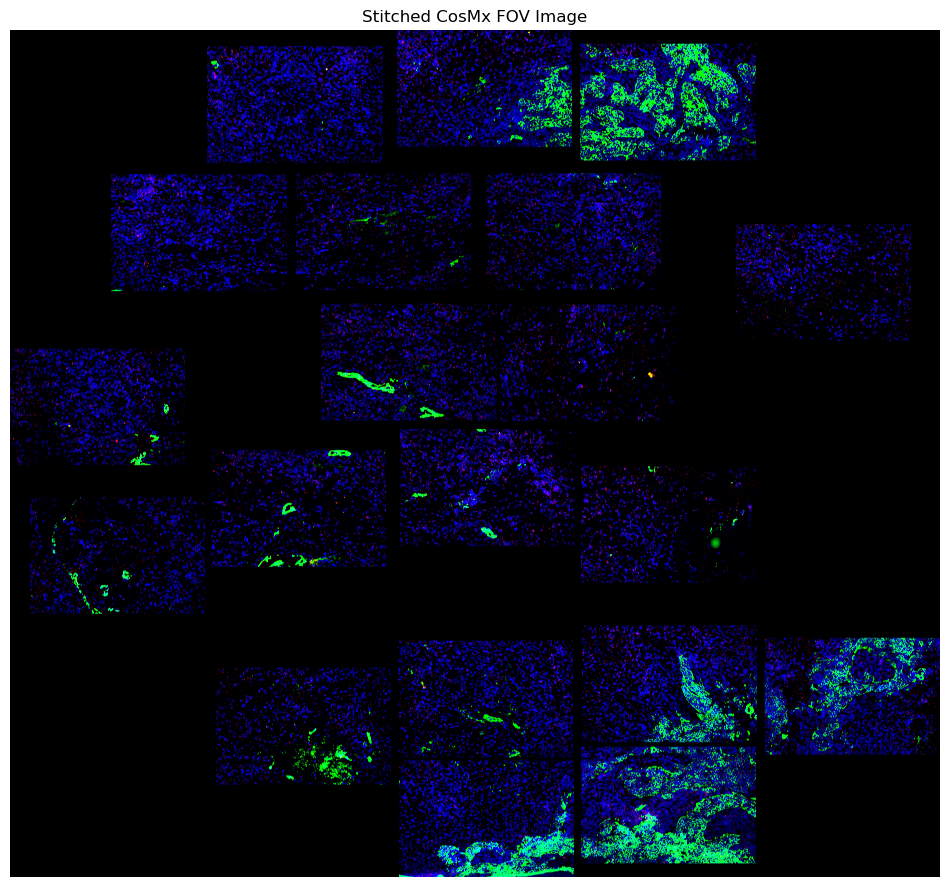

In [98]:
## Image & Metadata checks
fov_positions = pd.read_csv(data_read+"Run5452_S2_fov_positions_file.csv")
fov_positions = fov_positions[fov_positions['fov'].isin(fov_id)]
fov_positions.set_index("fov", inplace=True)

image_dir = data_read+'CellComposite'
image_ext = ".jpg"  # or .tif


min_x = fov_positions["x_global_px"].min()
min_y = fov_positions["y_global_px"].min()


fov_positions["x_offset"] = fov_positions["x_global_px"] - min_x
fov_positions["y_offset"] = fov_positions["y_global_px"] - min_y


max_x = int(np.ceil((fov_positions["x_offset"].max() + xlim_image)))
max_y = int(np.ceil((fov_positions["y_offset"].max() + ylim_image)))

stitched = np.zeros((max_y, max_x, 3), dtype=np.uint8)

for fov, row in fov_positions.iterrows():
    fov_name = f"CellComposite_F{int(fov):03d}"
    img_path = f"{image_dir}/{fov_name}{image_ext}"
    img = cv2.imread(img_path)
    img = cv2.flip(img, 0)
    if img is None:
        print(f"Could not load {img_path}")
        continue

    x_offset = int(row["x_offset"])
    y_offset = int(row["y_offset"])

    stitched[y_offset:y_offset+ylim_image, x_offset:x_offset+xlim_image] = img


plt.figure(figsize=(12, 12))
plt.imshow(cv2.cvtColor(stitched, cv2.COLOR_BGR2RGB))
plt.gca().invert_yaxis()
plt.axis("off")
plt.title("Stitched CosMx FOV Image")
plt.savefig(analysis_save+'stitched_fov.png')
plt.show()


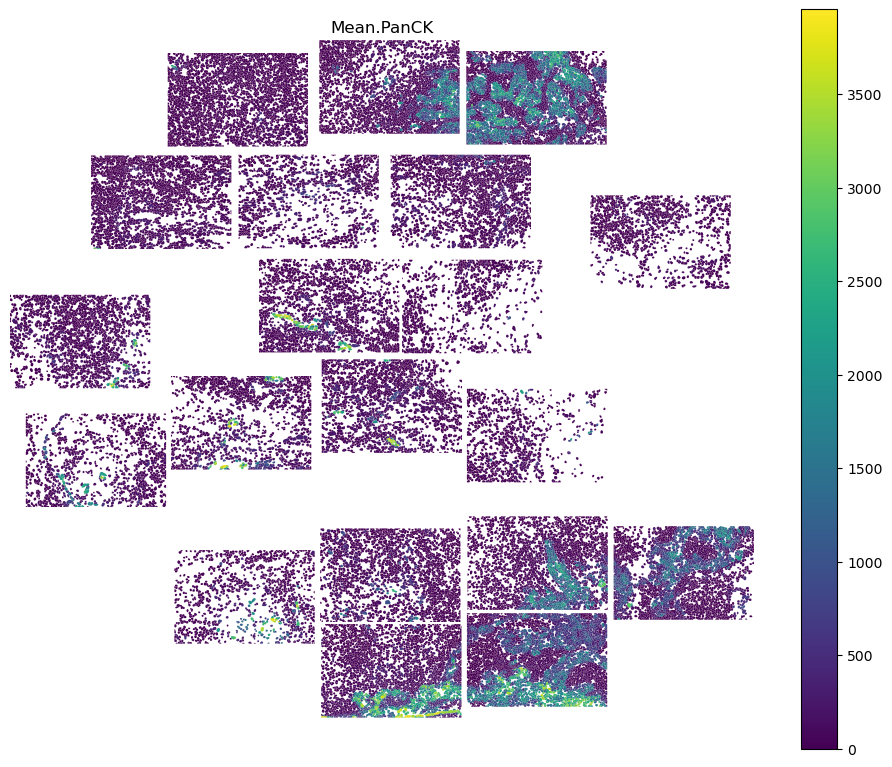

In [123]:
# Define the function to visualize continuous features based on polygon coordinates
polygon_file_global = polygon_file[['cell','fov', 'x_global_px', 'y_global_px']]
polygon_file_global['x_global_px'] = polygon_file_global['x_global_px'] - min_x
polygon_file_global['y_global_px'] = polygon_file_global['y_global_px'] - min_y

def plot_global_polygon_by_features(polygon_file, feature_df, feature, analysis_save, xlim_image, ylim_image):
    """
    Parameters
    ----------
    polygon_file : pd.DataFrame
        A long-format DataFrame with polygon coordinates for each cell.
        Must include: 'cell', 'fov', 'x_local_px', 'y_local_px'.

    feature_df : pd.DataFrame
        DataFrame containing cell-level features.
        Must include columns: 'cell' and the specified feature name.

    feature : str
        The name of the feature/column in `feature_df` to visualize (e.g., 'Mean.PanCK').

    fov_id : list
        A list of FOV IDs (integers or strings) to plot.

    analysis_save : str
        Path to the folder where the output image will be saved.

    xlim_image : int or float
        Maximum x-dimension of the image canvas for plotting polygons.

    ylim_image : int or float
        Maximum y-dimension of the image canvas for plotting polygons.
        
    image_path : str
        The path to the folder of image.
        
    len_image_col : int, optional (default=4)
        Number of columns in the subplot grid layout.
        Rows will be computed automatically based on number of FOVs.
    """
    feature_df = feature_df[['cell',feature]]
    df = feature_df.merge(polygon_file, on='cell')
    
    norm = colors.Normalize(vmin=df[feature].min(), vmax=df[feature].max())
    fig, ax = plt.subplots(figsize=(12,12))
    
    
    
    cmap = cm.viridis
        
    polygons = []
    for cell_id, group in df.groupby("cell"):
        color = cmap(norm(group[feature].iloc[0]))
        coords = group[['x_global_px','y_global_px']].values
        polygons.append(mpl.patches.Polygon(coords, closed=True, facecolor=color, edgecolor='red', linewidth=0.01))

    for j in polygons:
        ax.add_patch(j)
        
    ax.set_aspect('equal')

    ax.set_xlim(0, xlim_image)
    ax.set_ylim(0, ylim_image)


    sm = cm.ScalarMappable(norm=norm, cmap=cmap)
    sm.set_array([])  # required for matplotlib >= 3.1
    cbar = fig.colorbar(sm, ax=ax, shrink=0.8)
        
    ax.axis('off')
    plt.title(feature, fontsize=12)
    plt.savefig(analysis_save+'polygon_'+feature+'_global_fovs.png')
    plt.show()

# test run below code if necessary
plot_global_polygon_by_features(polygon_file_global, cell_meta, 'Mean.PanCK', analysis_save,max_x, max_y)

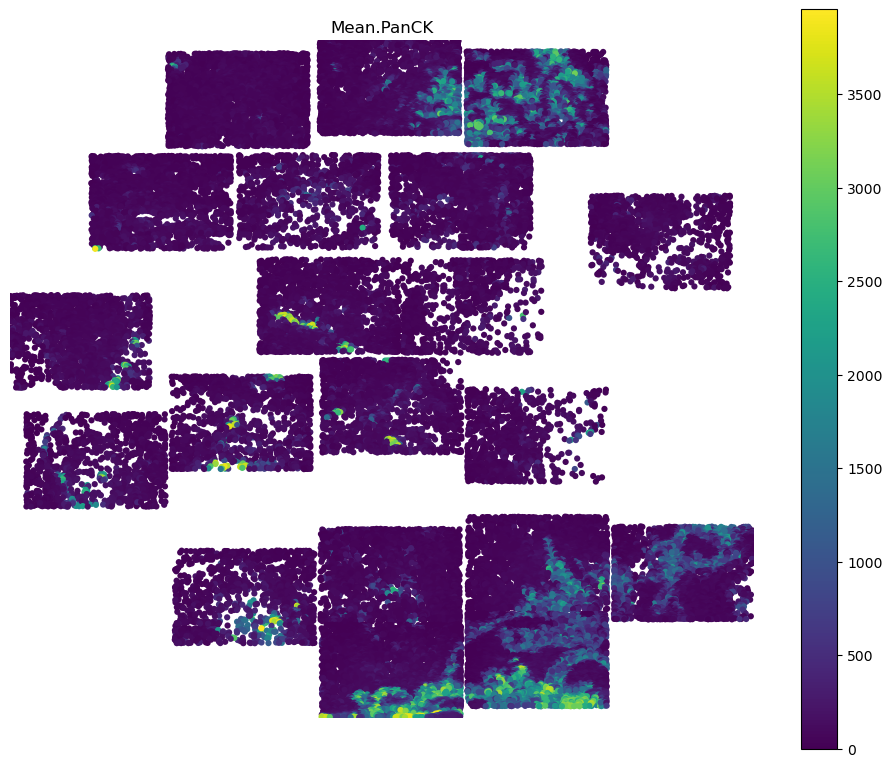

In [151]:
# Define the function to visualize continuous features based on dot coordinates
cell_meta = pd.read_csv(data_read+"Run5452_S2_metadata_file.csv")
cell_meta = cell_meta[cell_meta['fov'].isin(fov_id)]
cell_meta['cell'] = [str(i)+'_'+str(j) for i,j in zip(cell_meta['fov'].tolist(), cell_meta['cell_ID'].tolist())]
cell_meta_global = cell_meta
cell_meta_global['CenterX_global_px'] = cell_meta_global['CenterX_global_px'] - min_x
cell_meta_global['CenterY_global_px'] = cell_meta_global['CenterY_global_px'] - min_y

def plot_dot_by_features(dot_file, feature_df, feature, analysis_save, xlim_image, ylim_image):
    """
    Parameters
    ----------
    dot_file : pd.DataFrame
        A long-format DataFrame with polygon coordinates for each cell.
        Must include: 'cell', 'fov', 'x_local_px', 'y_local_px'.

    feature_df : pd.DataFrame
        DataFrame containing cell-level features.
        Must include columns: 'cell' and the specified feature name.

    feature : str
        The name of the feature/column in `feature_df` to visualize (e.g., 'Mean.PanCK').

    fov_id : list
        A list of FOV IDs (integers or strings) to plot.

    analysis_save : str
        Path to the folder where the output image will be saved.

    xlim_image : int or float
        Maximum x-dimension of the image canvas for plotting polygons.

    ylim_image : int or float
        Maximum y-dimension of the image canvas for plotting polygons.

    len_image_col : int, optional (default=4)
        Number of columns in the subplot grid layout.
        Rows will be computed automatically based on number of FOVs.
    """
    feature_df = feature_df[['cell', feature]]
    df = feature_df.merge(dot_file, on='cell')
    

    # Set color normalization globally
    norm = colors.Normalize(vmin=df[feature].min(), vmax=df[feature].max())
    cmap = cm.viridis

    fig, ax = plt.subplots(figsize=(12, 12))

    

    # Pick a point per cell — you can use the centroid or first point
    cell_points = df

    ax.scatter(
        cell_points["CenterX_global_px"],
        cell_points["CenterY_global_px"],
        c=cell_points[feature],
        cmap=cmap,
        norm=norm,
        s=20,             # size of dots
        edgecolors='none' # optional
    )

    ax.set_aspect('equal')
    ax.set_xlim(0, xlim_image)
    ax.set_ylim(0, ylim_image)
    ax.axis('off')

    # Add colorbar
    sm = cm.ScalarMappable(norm=norm, cmap=cmap)
    sm.set_array([])
    cbar = fig.colorbar(sm, ax=ax, shrink=0.8)

    
    # Global title and layout
    plt.title(feature, fontsize=12)
    plt.savefig(os.path.join(analysis_save, f'dotplot_{feature}_global_fov.png'))
    plt.show()

# test run below code if necessary
plot_dot_by_features(cell_meta_global[['CenterX_global_px','CenterY_global_px','cell']], 
                     cell_meta_global[['cell','Mean.PanCK']], 
                     'Mean.PanCK', 
                     analysis_save,
                     max_x, 
                     max_y)

## Step 6: Filter and Save Data Based on QC Results

After computing QC metrics, we apply final filters to remove low-quality cells and low-confidence genes, then save the cleaned dataset for downstream analysis.


In [81]:
## filter and save the data for adata
counts = df_gene.loc[df_obs.index.tolist(),]
cell_meta = cell_meta[cell_meta['cell'].isin(df_obs.index.tolist())]
cell_meta.index = cell_meta['cell'].tolist()
polygon_file = polygon_file[polygon_file['cell'].isin(df_obs.index.tolist())]

coordinates = cell_meta[['cell','CenterX_local_px', 'CenterY_local_px']]
coordinates.index = coordinates.cell.tolist()
coordinates = coordinates.drop(['cell'], axis=1)
coordinates.index.tolist() == counts.index.tolist()

cell_meta.to_csv(data_save+'filtered_metadata_file.csv')
counts.to_csv(data_save+'filtered_exprMat_file.csv')
polygon_file.to_csv(data_save+'filtered_polygons.csv')
coordinates.to_csv(data_save+'filtered_coordinates.csv')